### cnn wild animal big cat binary classification
- datasets: './data/train/', './data/validation/', './data/test/'
- learning method: supervised learning, binary classification
- learninf algorithm: transfer learning, vgg16 model, resnet model
- frame work: Pytorch

In [99]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from PIL import Image

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optima
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.data import DataLoader

from torchvision import transforms
from torchvision.transforms import v2
from torchvision.datasets import ImageFolder
import torchvision.models as models
from torchinfo import summary

from torchmetrics.classification import BinaryAccuracy, BinaryF1Score, BinaryConfusionMatrix

In [101]:
# 이미지 크기 재조정 및 tensor화

img_transforms = v2.Compose([
    v2.Resize(size=(256, 256), interpolation=v2.InterpolationMode.BILINEAR),
    v2.RandomResizedCrop(224),
    v2.ToImage(),
    v2.ToDtype(torch.float32, scale= True),
    v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

img_v_trans = v2.Compose([
    v2.Resize(size=(256, 256), interpolation=v2.InterpolationMode.BILINEAR),
    v2.ToImage(),
    v2.ToDtype(torch.float32, scale= True),
    v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

In [131]:
img_train = ImageFolder(root='./data/train/', transform=img_transforms)
img_val = ImageFolder(root='./data/validation/', transform=img_v_trans)
img_test = ImageFolder(root='./data/test/', transform=img_v_trans)

In [55]:
img_train

Dataset ImageFolder
    Number of datapoints: 2017
    Root location: ./data/train
    StandardTransform
Transform: Compose(
               RandomHorizontalFlip(p=0.5)
               RandomVerticalFlip(p=0.5)
               RandomRotation(degrees=[-1.0, 1.0], interpolation=nearest, expand=False, fill=0)
               Resize(size=(256, 256), interpolation=bilinear, max_size=None, antialias=True)
               ToTensor()
               Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
           )

In [103]:
img_train.classes

['others', 'tiger']

In [104]:
img_train.class_to_idx

{'others': 0, 'tiger': 1}

In [142]:
LABEL_TRANSLATE = {value:key for key, value in img_train.class_to_idx.items()}
LABEL_TRANSLATE

{0: 'others', 1: 'tiger'}

In [132]:
print(f"train_datasets: {len(img_train)}")
print(f"val_datasets: {len(img_val)}")
print(f"test_datasets: {len(img_test)}")

train_datasets: 2017
val_datasets: 200
test_datasets: 60


In [134]:
def show_image_dataset(datasets):
    name = datasets.classes

    fig, axes = plt.subplots(2, 5, figsize=(24, 15))

    for idx, (img_data, tagest) in enumerate(datasets):

        rotated_images = torch.Tensor(img_data)
        # normalization code
        image_min = rotated_images.min()
        image_max = rotated_images.max()
        rotated_images.clamp_(min=image_min, max=image_max)
        rotated_images.add_(-image_min).div_(image_max - image_min + 1e-5)
        
        axes[idx//5][idx%5].imshow(img_data.permute(1, 2 ,0))
        axes[idx//5][idx%5].set_title(name[tagest], fontsize=25)
        axes[idx//5][idx%5].axis('off')
        
        if idx == 9: break
        
    plt.tight_layout()
    # plt.axis('off')
    plt.show()

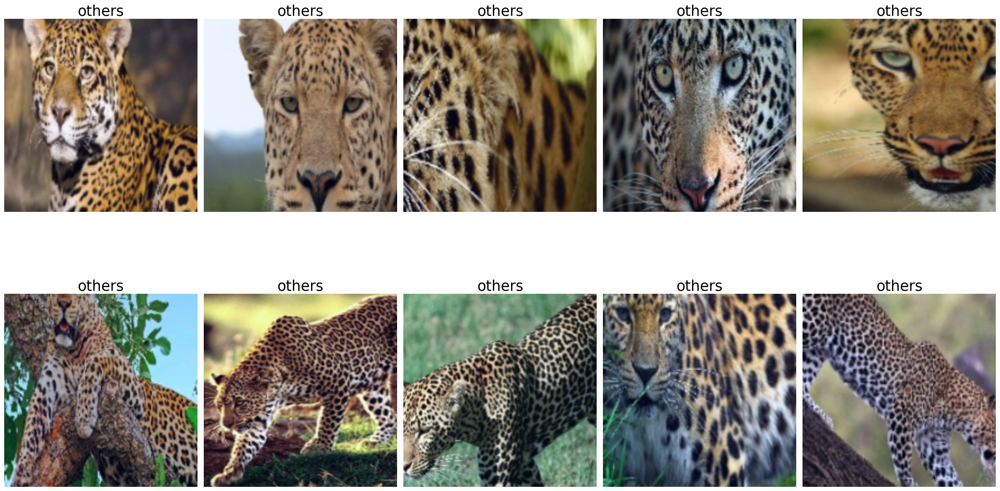

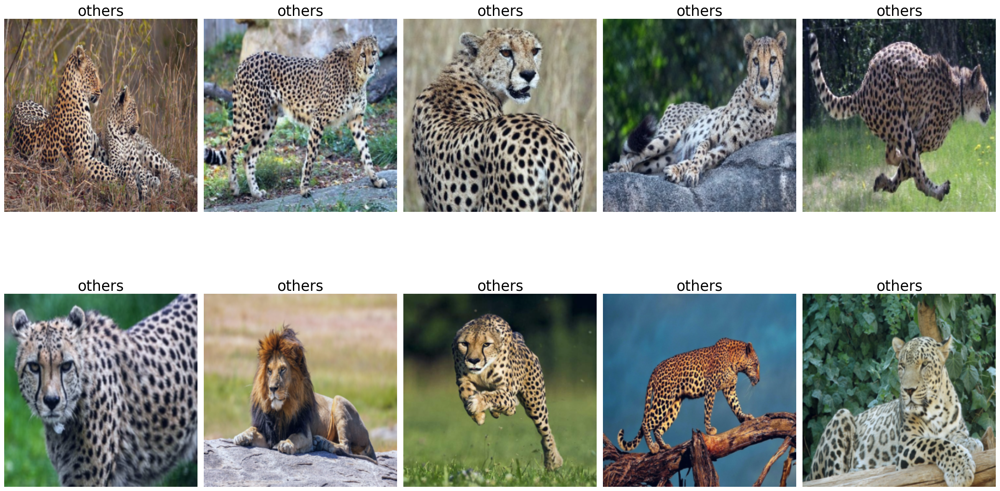

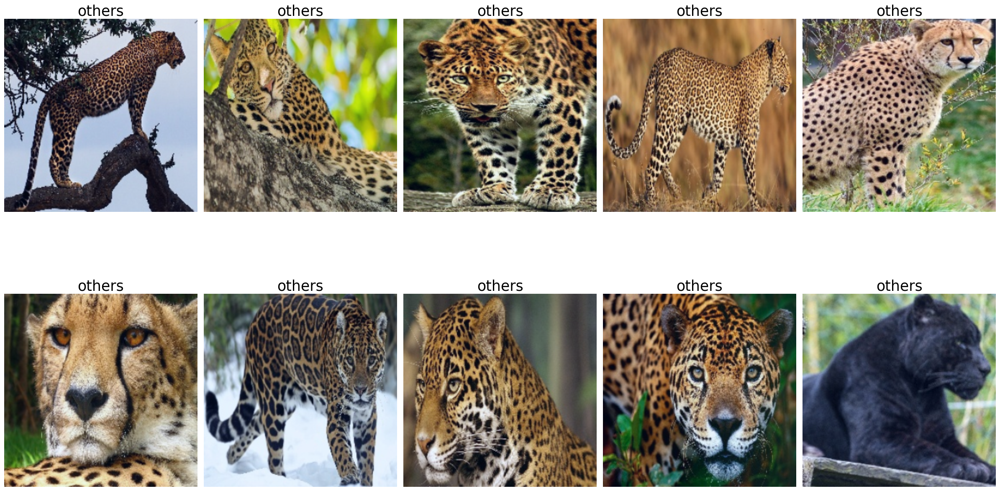

In [135]:
show_image_dataset(img_train)
show_image_dataset(img_val)
show_image_dataset(img_test)

In [236]:
vgg16_BC_model = models.vgg16(weights=models.VGG16_Weights.IMAGENET1K_V1)

In [237]:
# model structure
print(vgg16_BC_model)
summary(vgg16_BC_model)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

Layer (type:depth-idx)                   Param #
VGG                                      --
├─Sequential: 1-1                        --
│    └─Conv2d: 2-1                       1,792
│    └─ReLU: 2-2                         --
│    └─Conv2d: 2-3                       36,928
│    └─ReLU: 2-4                         --
│    └─MaxPool2d: 2-5                    --
│    └─Conv2d: 2-6                       73,856
│    └─ReLU: 2-7                         --
│    └─Conv2d: 2-8                       147,584
│    └─ReLU: 2-9                         --
│    └─MaxPool2d: 2-10                   --
│    └─Conv2d: 2-11                      295,168
│    └─ReLU: 2-12                        --
│    └─Conv2d: 2-13                      590,080
│    └─ReLU: 2-14                        --
│    └─Conv2d: 2-15                      590,080
│    └─ReLU: 2-16                        --
│    └─MaxPool2d: 2-17                   --
│    └─Conv2d: 2-18                      1,180,160
│    └─ReLU: 2-19                

In [238]:
# 사전학습된 모델의 파라미터 비활성화 설정
for named, params in vgg16_BC_model.named_parameters():
    print(f"[{named}] - {params.shape}")
    # 역전파시 업데이트가 되지 않도록 설정
    params.requires_grad = False

[features.0.weight] - torch.Size([64, 3, 3, 3])
[features.0.bias] - torch.Size([64])
[features.2.weight] - torch.Size([64, 64, 3, 3])
[features.2.bias] - torch.Size([64])
[features.5.weight] - torch.Size([128, 64, 3, 3])
[features.5.bias] - torch.Size([128])
[features.7.weight] - torch.Size([128, 128, 3, 3])
[features.7.bias] - torch.Size([128])
[features.10.weight] - torch.Size([256, 128, 3, 3])
[features.10.bias] - torch.Size([256])
[features.12.weight] - torch.Size([256, 256, 3, 3])
[features.12.bias] - torch.Size([256])
[features.14.weight] - torch.Size([256, 256, 3, 3])
[features.14.bias] - torch.Size([256])
[features.17.weight] - torch.Size([512, 256, 3, 3])
[features.17.bias] - torch.Size([512])
[features.19.weight] - torch.Size([512, 512, 3, 3])
[features.19.bias] - torch.Size([512])
[features.21.weight] - torch.Size([512, 512, 3, 3])
[features.21.bias] - torch.Size([512])
[features.24.weight] - torch.Size([512, 512, 3, 3])
[features.24.bias] - torch.Size([512])
[features.26.we

In [239]:
# model custom
class CustomVgg16Model(nn.Module):
    def __init__(self):
        super(CustomVgg16Model, self).__init__()    # 이러면 전의학습 들고오는가봄
        self.features = vgg16_BC_model.features
        self.avgpool = vgg16_BC_model.avgpool
        self.classifier = vgg16_BC_model.classifier
        self.custom_layer = nn.Sequential(
            nn.ReLU(),
            nn.Linear(1000, 500),
            nn.ReLU(),
            nn.Linear(500, 50),
            nn.ReLU(),
            nn.Linear(50, 1)
        )
    
    def forward(self, x):
        y = self.features(x)
        y = self.avgpool(y)
        y = torch.flatten(y, 1)
        y = self.classifier(y)
        y = F.sigmoid(self.custom_layer(y))
        
        return y

In [240]:
vgg16_BC_model = CustomVgg16Model()

In [180]:
print(vgg16_BC_model)
summary(vgg16_BC_model, input_size=(1, 3, 256, 256))

CustomVgg16Model(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=

Layer (type:depth-idx)                   Output Shape              Param #
CustomVgg16Model                         [1, 1]                    --
├─Sequential: 1-1                        [1, 512, 8, 8]            --
│    └─Conv2d: 2-1                       [1, 64, 256, 256]         1,792
│    └─ReLU: 2-2                         [1, 64, 256, 256]         --
│    └─Conv2d: 2-3                       [1, 64, 256, 256]         36,928
│    └─ReLU: 2-4                         [1, 64, 256, 256]         --
│    └─MaxPool2d: 2-5                    [1, 64, 128, 128]         --
│    └─Conv2d: 2-6                       [1, 128, 128, 128]        73,856
│    └─ReLU: 2-7                         [1, 128, 128, 128]        --
│    └─Conv2d: 2-8                       [1, 128, 128, 128]        147,584
│    └─ReLU: 2-9                         [1, 128, 128, 128]        --
│    └─MaxPool2d: 2-10                   [1, 128, 64, 64]          --
│    └─Conv2d: 2-11                      [1, 256, 64, 64]          29

In [241]:
# 사전학습된 모델의 파라미터 비활성화 설정
for named, params in vgg16_BC_model.named_parameters():
    print(f"[{named}] - {params.shape}")
    # 역전파시 업데이트가 되지 않도록 설정
    params.requires_grad = False

[features.0.weight] - torch.Size([64, 3, 3, 3])
[features.0.bias] - torch.Size([64])
[features.2.weight] - torch.Size([64, 64, 3, 3])
[features.2.bias] - torch.Size([64])
[features.5.weight] - torch.Size([128, 64, 3, 3])
[features.5.bias] - torch.Size([128])
[features.7.weight] - torch.Size([128, 128, 3, 3])
[features.7.bias] - torch.Size([128])
[features.10.weight] - torch.Size([256, 128, 3, 3])
[features.10.bias] - torch.Size([256])
[features.12.weight] - torch.Size([256, 256, 3, 3])
[features.12.bias] - torch.Size([256])
[features.14.weight] - torch.Size([256, 256, 3, 3])
[features.14.bias] - torch.Size([256])
[features.17.weight] - torch.Size([512, 256, 3, 3])
[features.17.bias] - torch.Size([512])
[features.19.weight] - torch.Size([512, 512, 3, 3])
[features.19.bias] - torch.Size([512])
[features.21.weight] - torch.Size([512, 512, 3, 3])
[features.21.bias] - torch.Size([512])
[features.24.weight] - torch.Size([512, 512, 3, 3])
[features.24.bias] - torch.Size([512])
[features.26.we

In [242]:
# 모델의 FC 파라미터 활성화 설정
for named, params in vgg16_BC_model.custom_layer.named_parameters():
    print(f"[{named}] - {params.shape}")
    params.requires_grad = True

[1.weight] - torch.Size([500, 1000])
[1.bias] - torch.Size([500])
[3.weight] - torch.Size([50, 500])
[3.bias] - torch.Size([50])
[5.weight] - torch.Size([1, 50])
[5.bias] - torch.Size([1])


In [42]:
# 그림 그리는 함수
def draw_two_plot(loss, r2, title):
    
    # 축을 2개 사용하고 싶음.
    fig, ax1 = plt.subplots(figsize=(7, 7))
    ax2 = ax1.twinx()
    
    ax1.plot(loss['train'], label=f"train loss mean: {sum(loss['train'])/len(loss['train']):.6f}", color='#5587ED')
    ax1.plot(loss['val'], label=f"validation loss mean: {sum(loss['val'])/len(loss['val']):.6f}", color='#F361A6')
    ax2.plot(r2['train'], label=f"train score max: {max(r2['train'])*100:.2f} %", color='#00007F')
    ax2.plot(r2['val'], label=f"validation score max: {max(r2['val'])*100:.2f} %", color='#99004C')
    
    fig.suptitle(f'{title} iris CNN binary classification', fontsize=15)
    ax1.set_ylabel('loss', fontsize=10, color='#5587ED')
    ax2.set_ylabel('score', fontsize=10, color='#00007F')
    
    fig.legend(fontsize='small', loc='lower left')
    # plt.xticks(np.arange(0, len(loss['train']), 2), labels=[x for x in range(1, len(loss['val'])+1, 2)])
    plt.show()

In [210]:
def predict(model, images, labels):
    
    with torch.no_grad():
        pred = model(images)
        pred_labels = (pred > 0.5).int()
        pred_labels = [LABEL_TRANSLATE[int(label)] for label in pred_labels.flatten()]
        real_labels = [LABEL_TRANSLATE[int(label)] for label in labels.flatten()]
    
    return pred_labels, real_labels

In [289]:
def predict_web(model, images):
    # model.eval()
    with torch.no_grad():
        pred = model(images)
        pred_labels = (pred > 0.5).int()
        pred_labels = LABEL_TRANSLATE[int(pred_labels.flatten())]
        # real_labels = [LABEL_TRANSLATE[int(label)] for label in labels.flatten()]
    
    return pred_labels

In [184]:
def testing(model, test_images, test_labels):
    test_labels = test_labels.unsqueeze(1).float()  # 차원이 맞지 않기 때문에 차원 추가
    
    with torch.no_grad():
        pred = model(test_images)
        loss = nn.BCELoss()(pred, test_labels)
        acc = BinaryAccuracy()(pred, test_labels)
        f1 = BinaryF1Score()(pred, test_labels)
        mat = BinaryConfusionMatrix()(pred, test_labels)
        
    return loss, acc, f1, mat

In [224]:
def training(model, train_datasets, val_datasets, epochs=100, lr=0.001, batch_size=64, patience=5):
    loss_dict = {'train':[], 'val':[]}
    acc_dict = {'train':[], 'val':[]}
    f1_dict = {'train':[], 'val':[]}
    
    optimizer = optima.Adam(model.parameters(), lr=lr)
    train_data_dl = DataLoader(train_datasets, batch_size=batch_size, shuffle=True)
    val_data_dl = DataLoader(val_datasets, batch_size=10, shuffle=True)
    scheduler = ReduceLROnPlateau(optimizer, patience=patience, mode='min')
    
    save_param = './model/CNN_bc_custom_clf_params.pth'
    save_model = './model/CNN_bc_custom_clf_model.pth'
    
    train_batch_cnt = len(train_datasets) / batch_size
    val_batch_cnt = len(val_datasets) / 10
    
    for epoch in range(1, epochs+1):
        total_t_loss, total_t_acc, total_t_f1 = 0, 0, 0
        total_v_loss, total_v_acc, total_v_f1 = 0, 0, 0
        
        model.train()
        for images, labels in train_data_dl:
            # batch_cnt = len(train_datasets) / batch_size
            labels = labels.unsqueeze(1).float()

            pred = model(images)
            
            loss = nn.BCELoss()(pred, labels)
            total_t_loss += loss
            
            acc = BinaryAccuracy()(pred, labels)
            total_t_acc += acc
            
            score = BinaryF1Score()(pred, labels)
            total_t_f1 += score
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
        
        model.eval()
        with torch.no_grad():
            for images, labels in val_data_dl:
                # batch_cnt = len(val_datasets) / batch_size
                v_loss, v_acc, v_score, _ = testing(model, images, labels)

                total_v_loss += v_loss
                total_v_acc += v_acc
                total_v_f1 += v_score
        
        train_loss = (total_t_loss/train_batch_cnt).item()
        train_acc = (total_t_acc/train_batch_cnt)
        train_score = (total_t_f1/train_batch_cnt).item()
        val_loss = (total_v_loss/val_batch_cnt).item()
        val_acc = (total_v_acc/val_batch_cnt)
        val_score = (total_v_f1/val_batch_cnt).item()
        
        loss_dict['train'].append(train_loss)
        loss_dict['val'].append(val_loss)
        acc_dict['train'].append(train_acc)
        acc_dict['val'].append(val_acc)
        f1_dict['train'].append(train_score)
        f1_dict['val'].append(val_score)

        if epoch%5 == 0:
            print('---check point---')
            print(f"[{epoch:5}/{epochs:5}]  [Train]       loss: {train_loss:.6f}, score: {train_score*100:.4f} %")
            print(f"[{epoch:5}/{epochs:5}]  [Validation]  loss: {val_loss:.6f}, score: {val_score*100:.4f} %\n")
            
        if len(acc_dict['val']) == 1:
            print("saved first")
            print(f"[{epoch:5}/{epochs:5}]  [Train]       loss: {train_loss:.6f}, score: {train_score*100:.4f} %")
            print(f"[{epoch:5}/{epochs:5}]  [Validation]  loss: {val_loss:.6f}, score: {val_score*100:.4f} %\n")
            torch.save(model.state_dict(), save_param)
            torch.save(model, save_model)
        else:
            if acc_dict['val'][-1] >= max(acc_dict['val']):
                print(f"[{epoch:5}/{epochs:5}]  saved model")
                print(f"[{epoch:5}/{epochs:5}]  [Train]       loss: {train_loss:.6f}, score: {train_score*100:.4f} %")
                print(f"[{epoch:5}/{epochs:5}]  [Validation]  loss: {val_loss:.6f}, score: {val_score*100:.4f} %\n")
                torch.save(model.state_dict(), save_param)
                torch.save(model, save_model)
                
        scheduler.step(val_loss)
        
        if scheduler.num_bad_epochs >= scheduler.patience:
            print('성능 및 손실의 개선이 없어서 학습을 중단합니다.\n')
            print(f"[{epoch:5}/{epochs:5}]  [Train]       loss: {train_loss:.6f}, score: {train_score*100:.4f} %")
            print(f"[{epoch:5}/{epochs:5}]  [Validation]  loss: {val_loss:.6f}, score: {val_score*100:.4f} %")
            print(f"[{epoch:5}/{epochs:5}]  [Train] accuracy: {train_acc*100:.4f} %, [Validation] accuracy:{val_acc*100:.4f} %")
            break
        
    return loss_dict, acc_dict, f1_dict

In [243]:
loss_dict, acc_dict, f1_dict = training(vgg16_BC_model, img_train, img_val)

c:\Users\PC\anaconda3\envs\torch_cv_38\lib\site-packages\PIL\Image.py:1056: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


saved first
[    1/  100]  [Train]       loss: 0.141560, score: 95.0631 %
[    1/  100]  [Validation]  loss: 0.028389, score: 94.0598 %

[    2/  100]  saved model
[    2/  100]  [Train]       loss: 0.051898, score: 99.6827 %
[    2/  100]  [Validation]  loss: 0.033651, score: 99.1608 %

[    3/  100]  saved model
[    3/  100]  [Train]       loss: 0.047583, score: 99.8906 %
[    3/  100]  [Validation]  loss: 0.024345, score: 99.0598 %

[    4/  100]  saved model
[    4/  100]  [Train]       loss: 0.048290, score: 99.9463 %
[    4/  100]  [Validation]  loss: 0.018560, score: 99.2857 %

---check point---
[    5/  100]  [Train]       loss: 0.044981, score: 99.8455 %
[    5/  100]  [Validation]  loss: 0.019795, score: 98.7302 %

---check point---
[   10/  100]  [Train]       loss: 0.040065, score: 100.1130 %
[   10/  100]  [Validation]  loss: 0.011587, score: 100.0000 %

[   10/  100]  saved model
[   10/  100]  [Train]       loss: 0.040065, score: 100.1130 %
[   10/  100]  [Validation]  

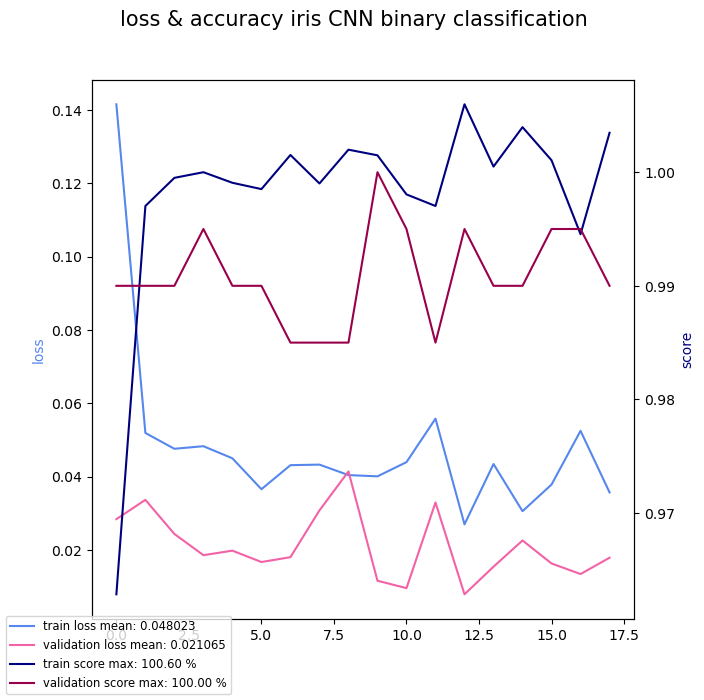

In [244]:
draw_two_plot(loss_dict, acc_dict, 'loss & accuracy')

In [245]:
vgg16_BC_model = torch.load('./model/CNN_bc_custom_clf_model.pth', weights_only=False)

In [246]:
test_loader = DataLoader(img_test, batch_size=len(img_test))

In [247]:
test_loader.batch_size

60

In [248]:
for image, label in test_loader:
    test_loss, test_acc, test_f1, test_mat = testing(vgg16_BC_model, image, label)

In [249]:
print(f'test loss: {test_loss:.6f}')
print(f"test accuracy: {test_acc*100:.4f} %")
print(f"test f1 score: {test_f1*100:.4f} %")

test loss: 0.034882
test accuracy: 98.3333 %
test f1 score: 98.3051 %


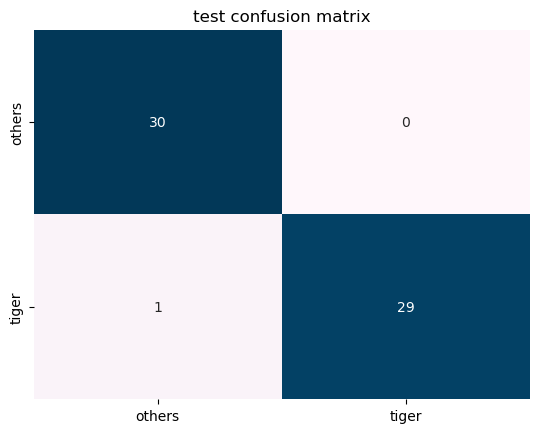

In [250]:
sns.heatmap(test_mat, annot=True, fmt=f'.0f', cmap='PuBu', cbar=False)
plt.title('test confusion matrix')
plt.xticks(np.arange(2)+0.5, labels=[LABEL_TRANSLATE[x] for x in range(2)])
plt.yticks(np.arange(2)+0.5, labels=[LABEL_TRANSLATE[x] for x in range(2)])
plt.show()

In [253]:
def show_predict_image(model, data_loader, num):
    cnt = 0
    for image, label in data_loader:
        if cnt == num:
            break
        
        image = image
        label = label
        cnt += 1
    
    rotated_images = torch.Tensor(image[num])
    # normalization code
    image_min = rotated_images.min()
    image_max = rotated_images.max()
    rotated_images.clamp_(min=image_min, max=image_max)
    rotated_images.add_(-image_min).div_(image_max - image_min + 1e-5)
    
    pred_label, real_label = predict(model, image, label)
    
    plt.imshow(rotated_images.permute(1, 2, 0).numpy())
    plt.title(f"predict: {pred_label[num]}\nreal: {real_label[num]}", color='green' if pred_label[num] == real_label[num] else 'red')
    plt.tight_layout()
    plt.axis('off')
    plt.show()

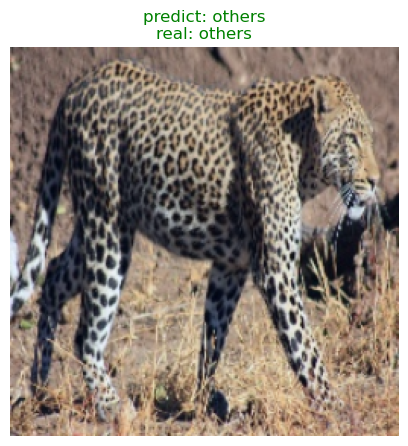

In [254]:
show_predict_image(vgg16_BC_model, test_loader, 10)

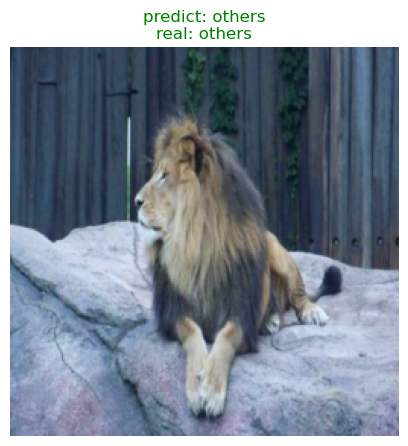

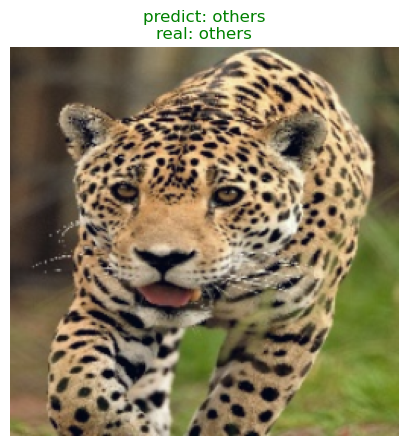

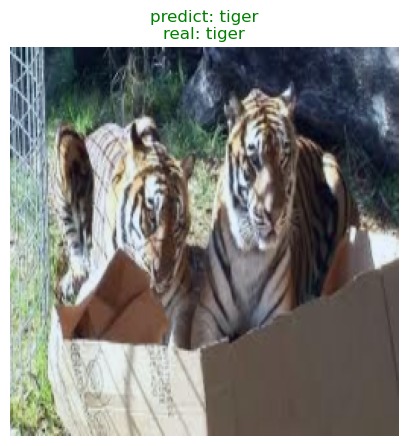

In [256]:
show_predict_image(vgg16_BC_model, test_loader, 24)
show_predict_image(vgg16_BC_model, test_loader, 13)
show_predict_image(vgg16_BC_model, test_loader, 50)

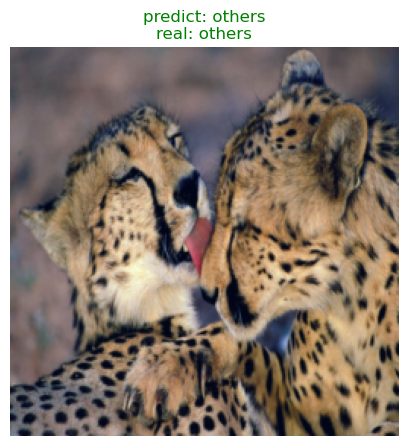

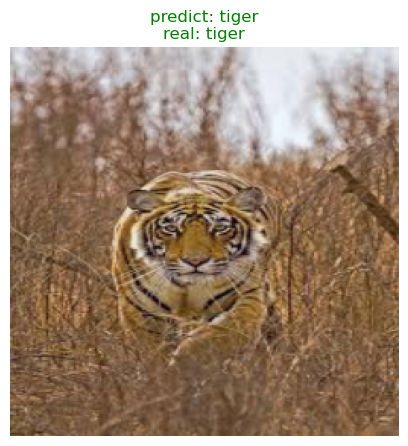

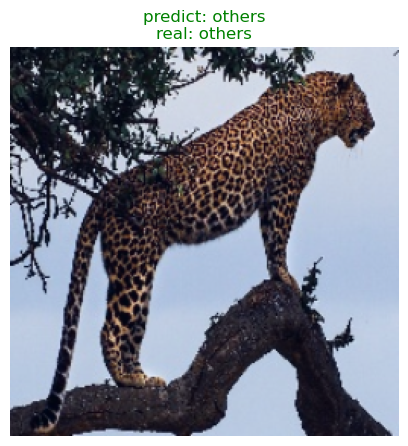

In [257]:
show_predict_image(vgg16_BC_model, test_loader, 20)
show_predict_image(vgg16_BC_model, test_loader, 59)
show_predict_image(vgg16_BC_model, test_loader, 0)

In [294]:
real_test_path ='./data/test_web/'

image_file_list = os.listdir(real_test_path)
image_file_list

['bug.jpg',
 'cat_cosplay.jpg',
 'cheetah (1).jpg',
 'cheetah (2).jpg',
 'cheetah (3).jpg',
 'fashion.jpg',
 'fish.jpg',
 'image_2863.jpg',
 'leopard (1).jpg',
 'leopard (2).jpg',
 'leopard (3).jpg',
 'lion (1).jpg',
 'lion (2).jpg',
 'lion (3).jpg',
 'shark.jpg',
 'shoeses.jpg',
 'SIERRA_DSC0074-TN.jpg',
 'tiger (1).jpg',
 'tiger (2).jpg',
 'tiger (3).jpg',
 'tiger (4).jpg',
 'tiger (5).jpg',
 'tiger (6).jpg',
 'tiger (7).jpg',
 'tiger ficture (1).jpg',
 'tiger ficture (2).jpg',
 'tiger mouth.jpg',
 'tiger_cat.jpg',
 'tiger_dog.jpeg',
 'tiger_hairband.jpg',
 'waterdog.jpg',
 '제5인격_선지자_(호랑이ver)1_-_복사본.jpg']

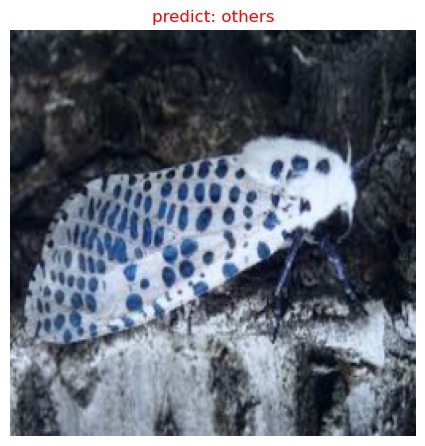

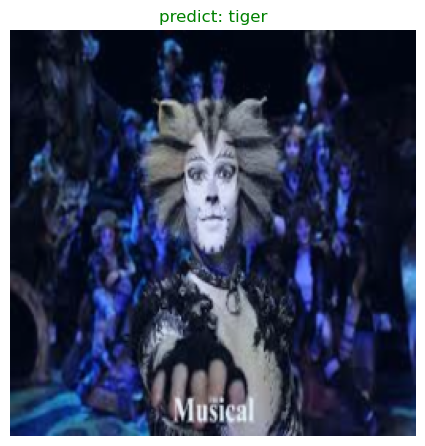

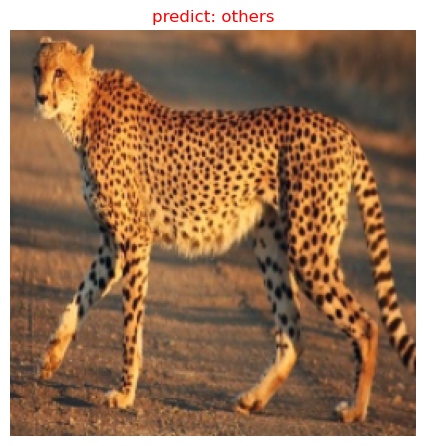

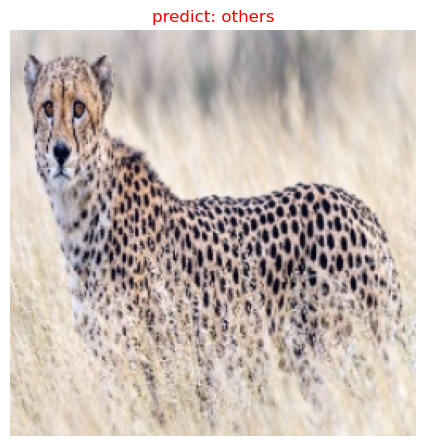

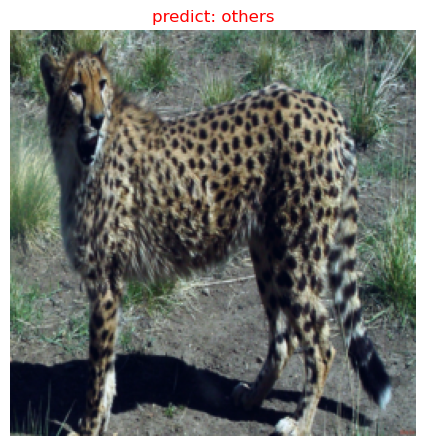

...

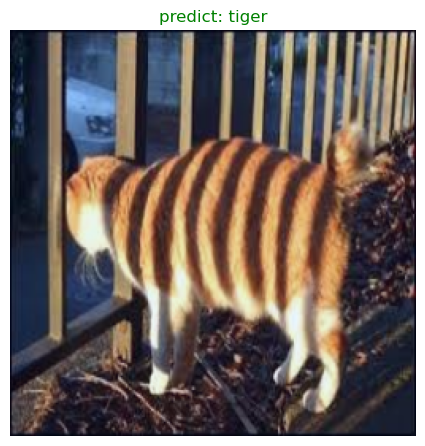

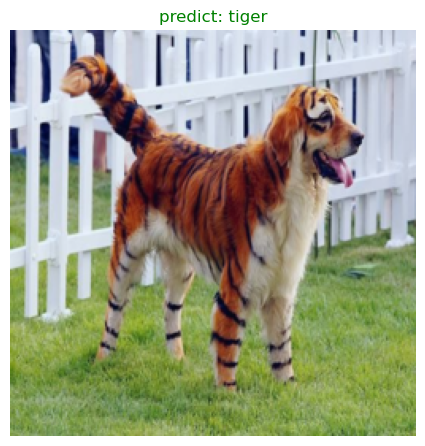

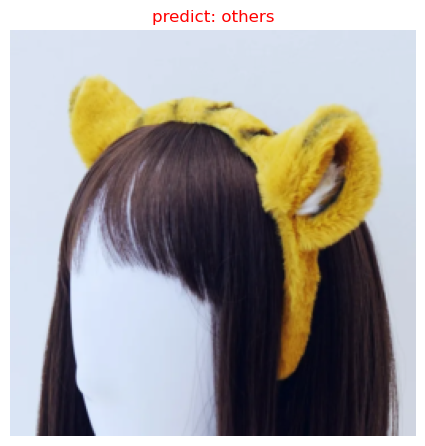

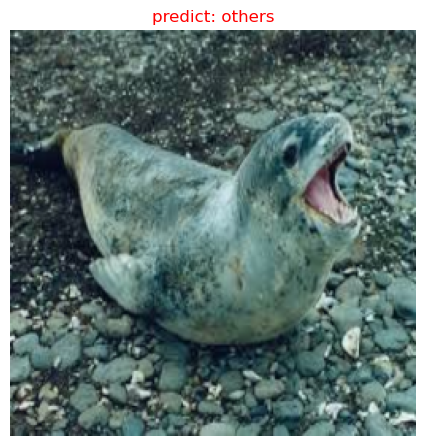

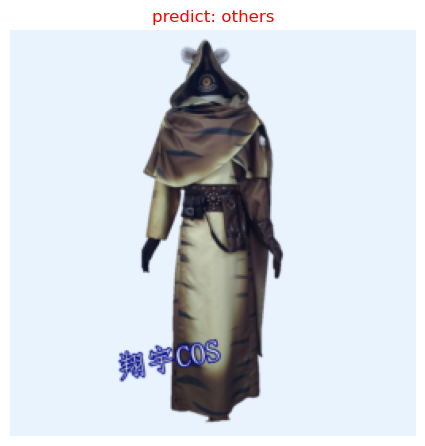

In [295]:
for i in range(len(image_file_list)):
    real_test_img = Image.open(real_test_path+image_file_list[i])
    real_test_img = img_v_trans(real_test_img)
    real_test_img = real_test_img.unsqueeze(0)
    # print(real_test_img.shape)
    label = predict_web(vgg16_BC_model, real_test_img)
    image = real_test_img.squeeze(0)
    # print(image.shape)
    
    # rotated_images = torch.Tensor(image[num])
    # normalization code
    image_min = image.min()
    image_max = image.max()
    image.clamp_(min=image_min, max=image_max)
    image.add_(-image_min).div_(image_max - image_min + 1e-5)
    
    # pred_label, real_label = predict(model, image, label)
    plt.imshow(image.permute(1, 2, 0).numpy())
    plt.title(f"predict: {label}", color='green' if label=='tiger' else 'red')
    plt.tight_layout()
    plt.axis('off')
    plt.show()